In [1]:
import pandas as pd

from scipy.optimize import curve_fit
from scipy import signal
from scipy import stats


In [2]:
df2 = pd.read_csv("01432805.txt", sep='\t', comment='#', header=0, skiprows=[29], parse_dates=[2])
df2['ts'] = df2.datetime.map(lambda x: x.timestamp())
df2 = df2[df2["107354_00010"]!="Eqp"]
df2["D2"] = pd.to_numeric(df2["107354_00010"])


/opt/conda/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3063: DtypeWarning: Columns (4) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [4]:
df1 = pd.read_csv("01589440.txt", sep='\t', comment='#', header=0, skiprows=[32], parse_dates=[2])
df1['ts'] = df1.datetime.map(lambda x: x.timestamp())
df1 = df1[df1["69744_00060"]!="Ice"]
df1["D1"] = pd.to_numeric(df1["69744_00060"])
#water_df = water_df.rename(columns={"69744_00060": "Discharge"})
df1["G1"] = pd.to_numeric(df1["69745_00065"])
#water_df = water_df.rename(columns={"69745_00065": "GageHeight"})
df1.head()

,agency_cd,site_no,datetime,tz_cd,69744_00060,69744_00060_cd,69745_00065,69745_00065_cd,ts,D1,G1
0,USGS,1589440,2007-02-01 00:00:00,EST,27,A:[91],NaN,NaN,1.170288e+09,27.0,NaN
1,USGS,1589440,2007-02-01 00:15:00,EST,27,A:[91],NaN,NaN,1.170289e+09,27.0,NaN
2,USGS,1589440,2007-02-01 00:30:00,EST,27,A:[91],NaN,NaN,1.170290e+09,27.0,NaN
3,USGS,1589440,2007-02-01 00:45:00,EST,27,A:[91],NaN,NaN,1.170291e+09,27.0,NaN
4,USGS,1589440,2007-02-01 01:00:00,EST,27,A:[91],NaN,NaN,1.170292e+09,27.0,NaN


In [5]:
tdf = df1[['ts', 'D1']].join(df2[['ts', 'D2']].set_index('ts'), how="inner", on='ts', lsuffix='l', rsuffix="r" )

In [6]:
tdf['D1'] = tdf['D1']#/tdf['D1'].max()
tdf['D2'] = tdf['D2']#/tdf['D2'].max()
tdf['D3'] = tdf['D2']*1.1
tdf['D4'] = tdf['D1']*1.1

In [7]:
from bokeh.models import ColumnDataSource
from bokeh.io import output_notebook, show
from bokeh.plotting import figure
output_notebook()

Loading BokehJS ...

In [154]:
tdf.head()

,ts,D1,D2
17827,1.191197e+09,3.84,18.0
17828,1.191198e+09,3.84,18.0
17829,1.191199e+09,3.84,17.9
17830,1.191200e+09,3.84,17.9
17831,1.191200e+09,3.84,17.9


In [188]:
# create a column data source for the plots to share
source = ColumnDataSource(tdf)

In [189]:
%%time
# create a new plot and add a renderer
p = figure(width=900, height=300)
p.circle('index', 'D1', source=source)
p.circle('index', 'D2', source=source, fill_color='red', line_color='red')

show(p)

CPU times: user 666 ms, sys: 76.6 ms, total: 742 ms
Wall time: 739 ms


In [190]:
%%time
# create a new plot and add a renderer
p = figure(width=900, height=300)
p.line('index', 'D1', source=source)
p.line('index', 'D2', source=source, line_color='red')

show(p)

CPU times: user 646 ms, sys: 92.8 ms, total: 739 ms
Wall time: 735 ms


In [8]:
import datashader as ds
import datashader.transfer_functions as tf
from collections import OrderedDict
import xarray as xr

In [9]:
tdf['x'] = tdf.index

CPU times: user 3.3 s, sys: 28 ms, total: 3.33 s
Wall time: 3.33 s


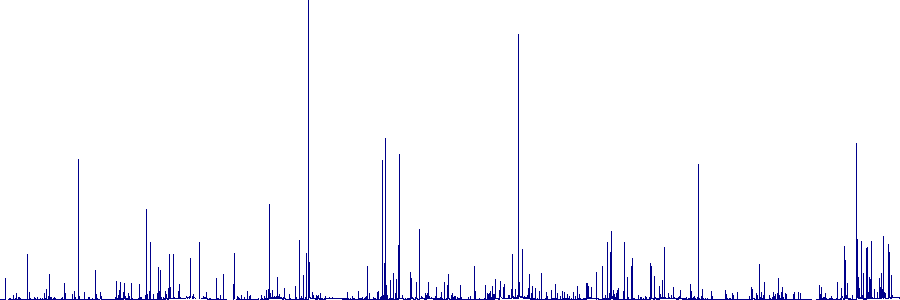

In [10]:
%%time
#cvs = ds.Canvas(x_range=x_range, y_range=y_range, plot_height=300, plot_width=900)
cvs = ds.Canvas(plot_height=300, plot_width=900)
aggs= OrderedDict((c, cvs.line(tdf, 'x', c)) for c in ['D1', 'D2'])
#aggs= cvs.line(tdf, 'x', 'Discharge')
img = tf.shade(aggs['D1'])
img

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
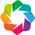

In [12]:
import holoviews as hv
from holoviews.operation.datashader import datashade
hv.extension('bokeh')

In [14]:
#colors = ['blue', 'red', 'green', 'yellow']
opts = hv.opts.RGB(width=900, height=600)
#copts = hv.opts.Curve( line_color=colors)

ndoverlay = hv.NdOverlay({c:hv.Curve((tdf['x'], tdf[c]), kdims=['x'], vdims=['Value']) for ic,c in enumerate(['D1', 'D2', 'D3', 'D4'])})#.opts(copts)
datashade(ndoverlay, normalization='linear', aggregator=ds.count()).opts(opts)

:DynamicMap   []
   :RGB   [x,Value]   (R,G,B,A)